In [1]:
!git clone --depth 1 https://github.com/tensorflow/models

Cloning into 'models'...
remote: Enumerating objects: 2605, done.
remote: Counting objects: 100% (2605/2605), done.
remote: Compressing objects: 100% (2164/2164), done.
remote: Total 2605 (delta 648), reused 1249 (delta 407), pack-reused 0
Receiving objects: 100% (2605/2605), 32.57 MiB | 28.43 MiB/s, done.
Resolving deltas: 100% (648/648), done.


In [ ]:
%%bash
sudo apt install -y protobuf-compiler
cd models/research/
protoc object_detection/protos/*.proto --python_out=.
cp object_detection/packages/tf2/setup.py .
python -m pip install .


In [29]:
import tensorflow as tf
import tensorflow_hub as hub
import requests
import cv2
import numpy as np
import matplotlib.pyplot as plt
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.utils import ops as utils_ops
from PIL import Image
from IPython.display import display
%matplotlib inline

In [4]:
moduleHandle = 'https://tfhub.dev/google/faster_rcnn/openimages_v4/inception_resnet_v2/1'

In [5]:
detector = hub.load(moduleHandle).signatures['default']

INFO:tensorflow:Saver not created because there are no variables in the graph to restore


INFO:tensorflow:Saver not created because there are no variables in the graph to restore


In [ ]:
detector

<ConcreteFunction pruned(images) at 0x7FC207079F90>

In [6]:
imagePath = 'https://futurearchitectureplatform.org/media/cache/c1/02/c102718392d6da8c5669695f672030ae.jpg'
imagePath = 'https://upload.wikimedia.org/wikipedia/commons/a/a7/StreetfoodNY.jpg'
imageResponse = requests. get(imagePath)
toUrl = '/content/sample_image2.jpg'
file = open(toUrl, "wb")
file. write(imageResponse. content)
file. close()


In [87]:
# 780 * 400
img = tf.io.read_file(toUrl)
img = tf.image.decode_jpeg(img)
convertedImage = tf.image.convert_image_dtype(img, tf.float32)[tf.newaxis, ...]

In [88]:
prediction = detector(convertedImage)

In [89]:
h, w, c = img.shape

In [10]:
def drawBoundingBox(image, topLeft, bottomRight, rgb, thickness):
  cv2.rectangle(image, topLeft, bottomRight,rgb, thickness)
  return image

def drawText(image, txt, topLeft, color, thickness, font = cv2.FONT_HERSHEY_SIMPLEX, fontScale = .7):
  cv2.putText(image, txt, topLeft, font, fontScale, color, thickness)
  return image

# plt.imshow(drawBoundingBox(imgNumpy, (10, 10), (100, 100), (255,0 ,0), 4))
# plt.figure(figsize=(20, 20))
# plt.imshow(drawText(imgNumpy, 'test', (100, 100), (0,255 ,0), 2, fontScale=.8))

In [11]:
def drawOneBox(boundingBoxes, classNames, score, index, img):
  fy = boundingBoxes[index, 0]
  fx = boundingBoxes[index, 1]
  ly = boundingBoxes[index, 2]
  lx = boundingBoxes[index, 3]
  label = classNames[index].decode('utf-8')
  probs = score[index]
  if probs < .5:
    return
  print(probs)
  
  drawText(img,label + ' ' + '{:.2f}'.format(probs), (int(fx - 10), fy), (0, 255, 0),1,fontScale=.8)
  drawBoundingBox(img, (fx, fy), (lx, ly),(255, 0, 0),1)

In [12]:
def showAllBoxes(prediction, img):
  boundingBoxes = np.array(prediction['detection_boxes'])
  boundingBoxes[:,0] *= h
  boundingBoxes[:,1] *= w
  boundingBoxes[:,2] *= h
  boundingBoxes[:,3] *= w
  boundingBoxes = boundingBoxes.astype(np.int32)
  classNames = np.array(prediction['detection_class_entities'])
  score = np.array(prediction['detection_scores'])
  row = boundingBoxes.shape[0]
  for i in range(row):
    drawOneBox(boundingBoxes, classNames, score, i, img)
  return img

In [90]:
imgNumpy = np.array(img)

In [ ]:
plt.imshow(imgNumpy)

# Object Detenction API


In [16]:
prediction = {key:value.numpy() for key, value in prediction.items()}

In [18]:
PATH_TO_LABELS = './models/research/object_detection/data/mscoco_label_map.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(PATH_TO_LABELS, use_display_name=True)

In [63]:
lst = list(prediction['detection_class_labels'])

In [74]:
lstIndex = list(prediction['detection_class_labels'])
lstNames = list(prediction['detection_class_entities'])
lstNames = [i.decode('utf-8') for i in lstNames]
classIndex = {}
for i in range(len(lstIndex)):
  index = lstIndex[i]
  name = lstNames[i]
  classIndex[index] = {'name' : name}

In [75]:
classIndex

{37: {'name': 'Cart'},
 50: {'name': 'Bus'},
 69: {'name': 'Person'},
 82: {'name': 'Tent'},
 103: {'name': 'Land vehicle'},
 120: {'name': 'Suit'},
 228: {'name': 'Woman'},
 308: {'name': 'Man'},
 400: {'name': 'Truck'},
 409: {'name': 'Wheel'},
 433: {'name': 'Clothing'},
 434: {'name': 'Footwear'},
 462: {'name': 'Building'},
 485: {'name': 'Window'},
 502: {'name': 'Human face'},
 514: {'name': 'Jeans'},
 552: {'name': 'Tire'},
 557: {'name': 'Umbrella'},
 571: {'name': 'Car'},
 594: {'name': 'Taxi'}}

In [ ]:
category_index

In [ ]:
viz_utils.visualize_boxes_and_labels_on_image_array(
    image = imgNumpy,
    boxes = prediction['detection_boxes'],
    classes = prediction['detection_class_labels'],
    scores = prediction['detection_scores'],
    category_index = classIndex,
    use_normalized_coordinates = True   
)

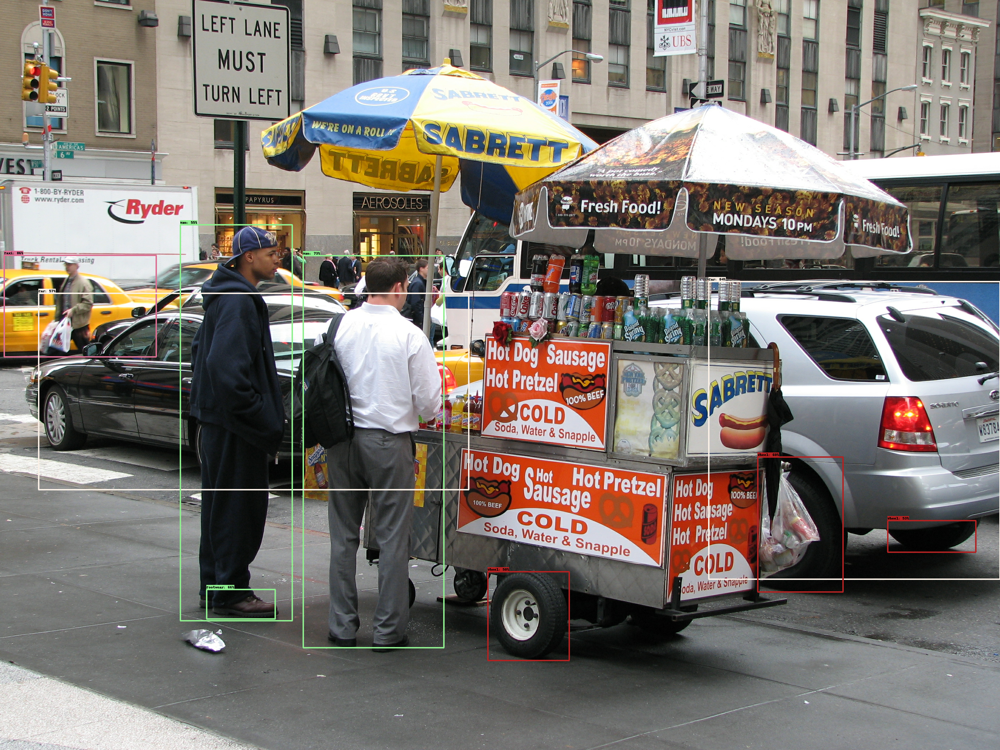

In [78]:
Image.fromarray(imgNumpy)

# Custom Viz


In [91]:
img = showAllBoxes(prediction, imgNumpy)

0.8590269
0.83592284
0.7265462
0.6580466
0.6009163
0.5692058
0.5511117
0.5313097
0.50392765


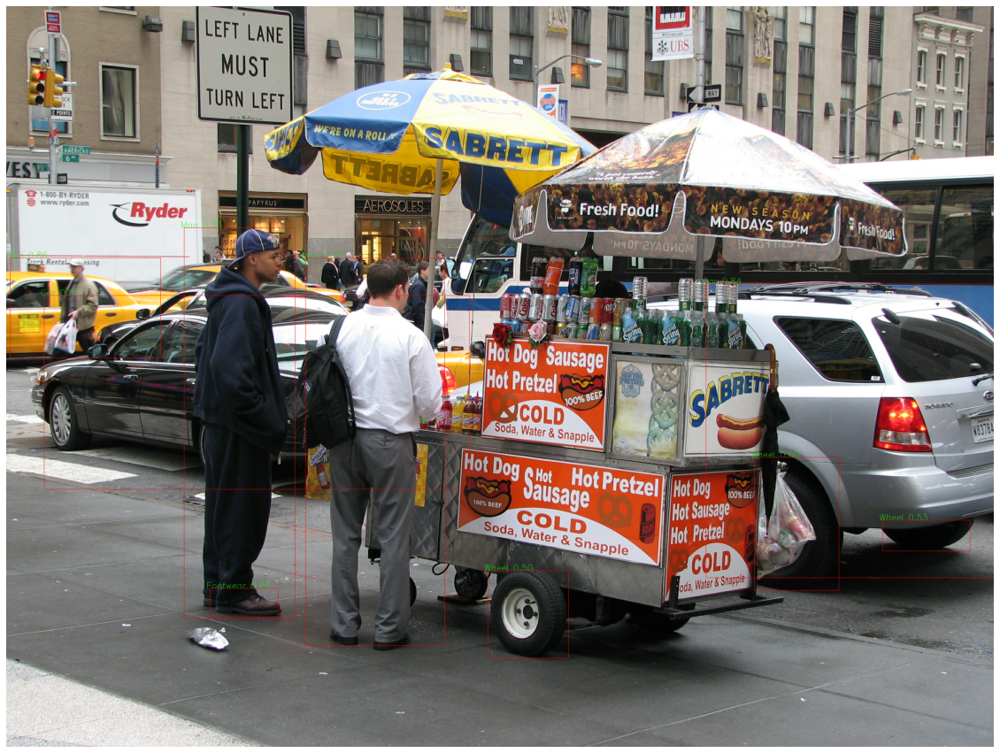

In [92]:
plt.figure(figsize=(20, 20))
plt.xticks([])
plt.yticks([])
plt.box(None)
plt.imshow(img)

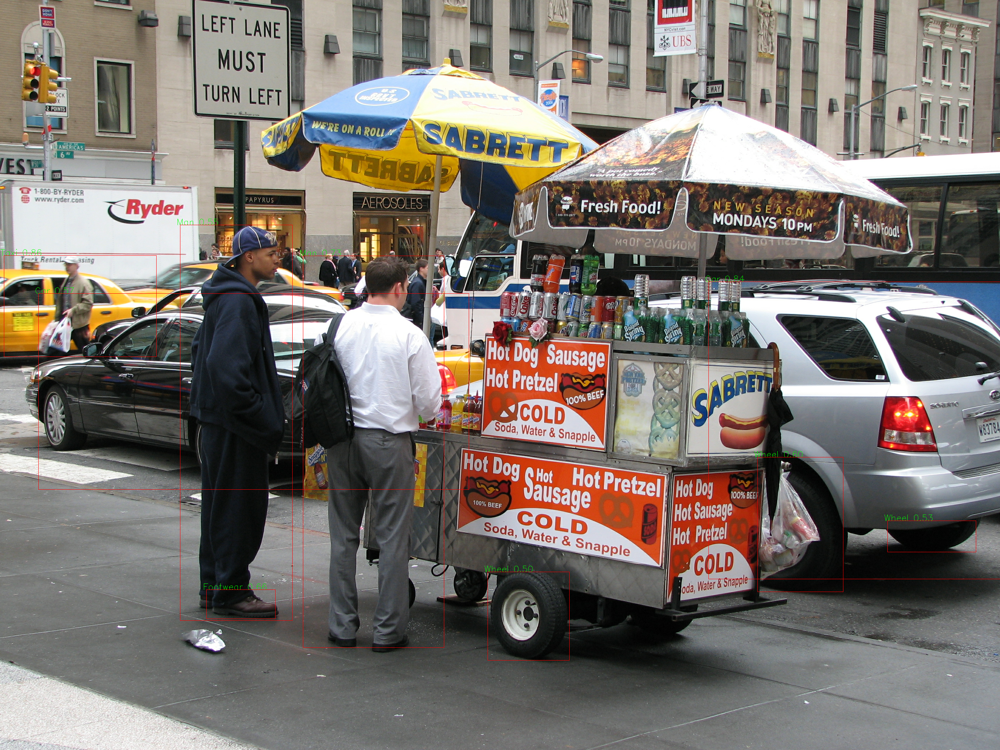

In [93]:
Image.fromarray(imgNumpy)